# Execute morph.ipynb first, in order to produce interim results needdd here.

In [1]:
import numpy as np
from PIL import Image
from os.path import join

import src.tvData as tv
import src.constants as constants

In [2]:
df = tv.get_df(constants.FILES_S4, './data/gr_ringstrecke_s4/')
arr, df = tv.to_img_arr(df)

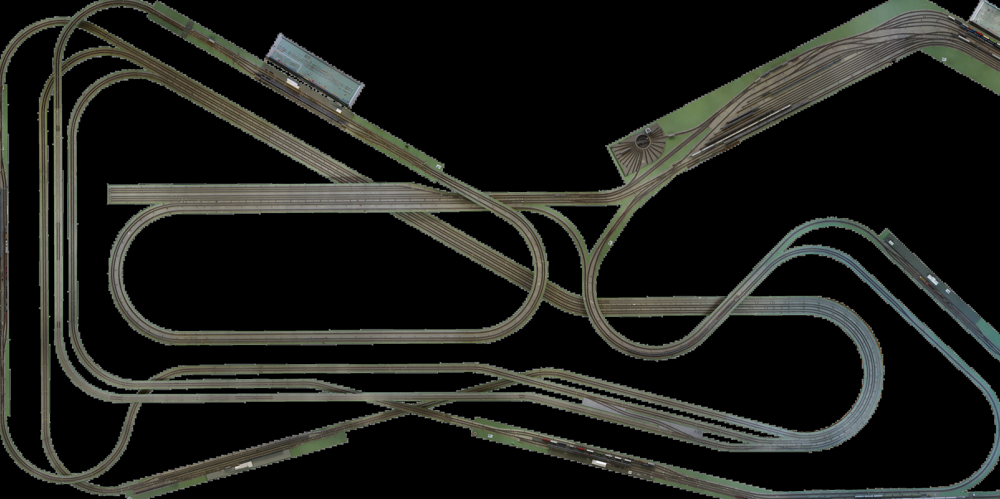

In [3]:
ortho_img = Image.open("./data/images/Eisenbahnlabor_5mm_cutted_s4.png").convert('RGB')
ortho_arr = np.array(ortho_img)
display(ortho_img)

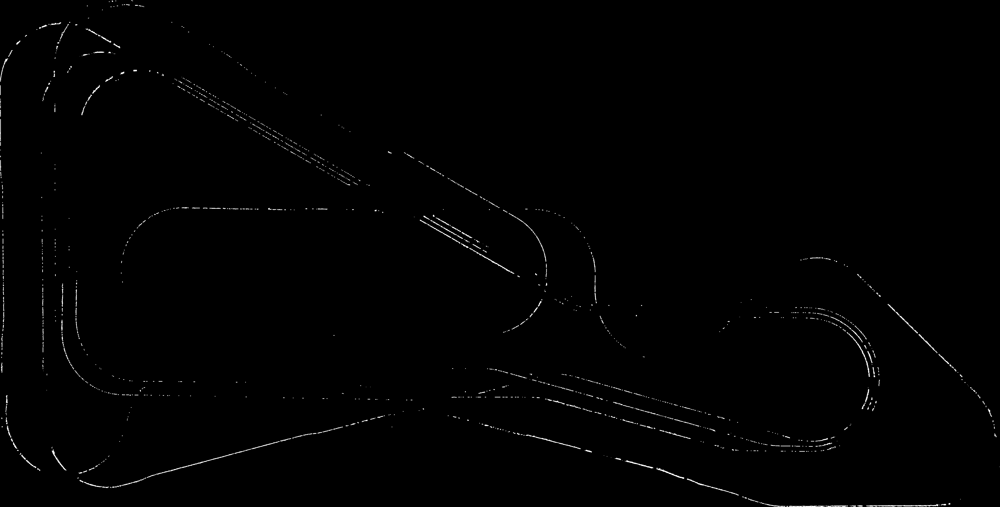

In [4]:
gp_img = Image.open(join(constants.DUMP, 'good_points.png'))
gp_img = gp_img.transpose(Image.Transpose.ROTATE_90)
gp_img = gp_img.transpose(Image.Transpose.FLIP_TOP_BOTTOM)

gp_arr = np.array(gp_img)
v, u = gp_arr.nonzero()
gp_arr = gp_arr[v.min():v.max(),u.min():u.max()]
gp_img = Image.fromarray(gp_arr)

display(gp_img)

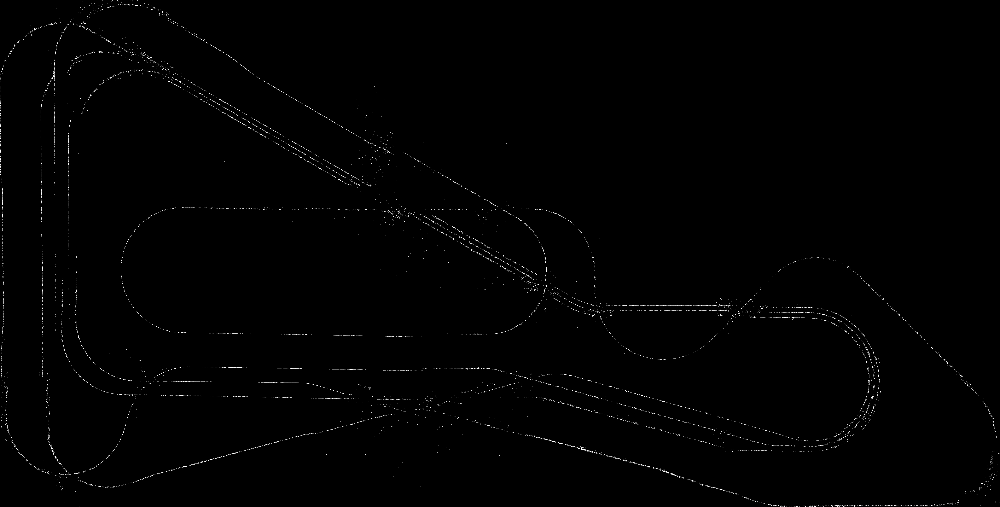

In [5]:
ap_arr = arr.T
ap_arr = ap_arr[v.min():v.max(),u.min():u.max()]
ap_img = Image.fromarray(ap_arr)
display(ap_img)

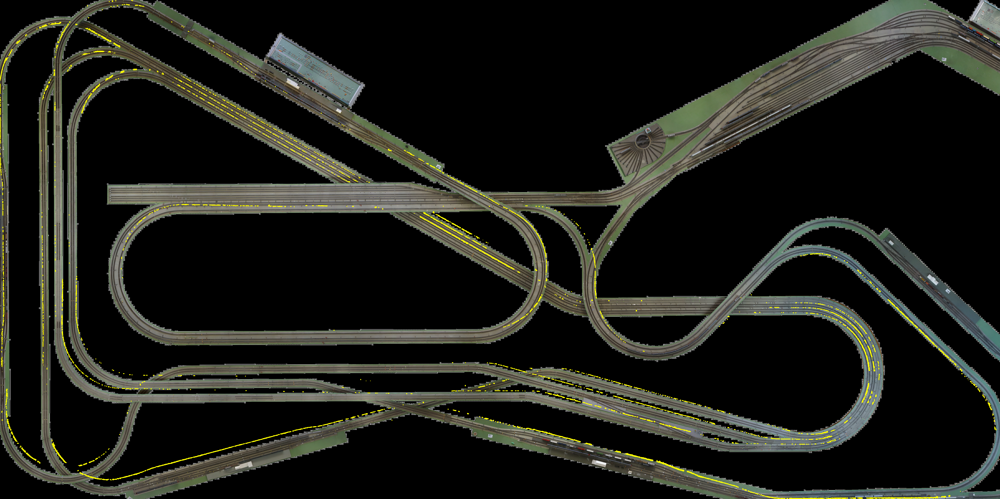

In [6]:
gp_img_scaled = gp_img.resize(ortho_img.size)
scaled_arr = np.array(gp_img_scaled)
idx = scaled_arr.nonzero()
marked_arr = ortho_arr.copy()
marked_arr[idx] = [255, 255, 0]
marked_img = Image.fromarray(marked_arr)
display(marked_img)

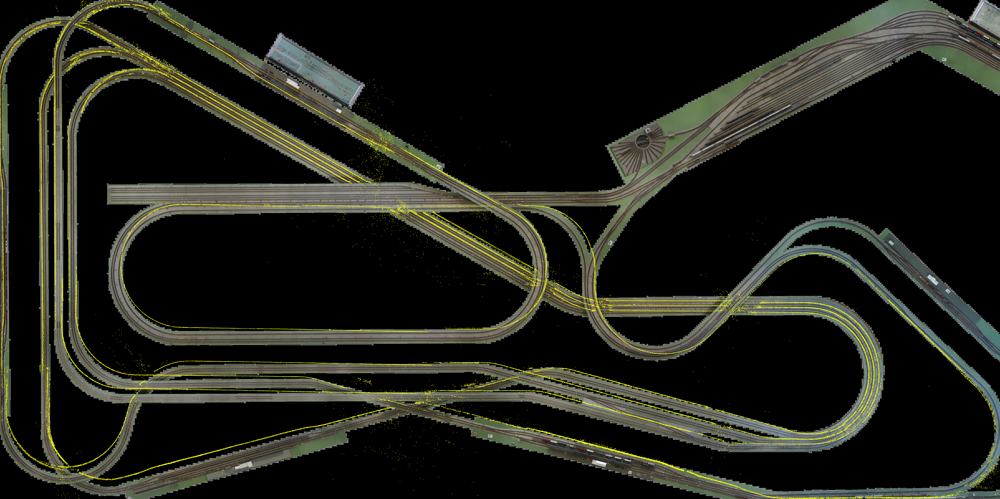

In [7]:
ap_img_scaled = ap_img.resize(ortho_img.size)
scaled_arr = np.array(ap_img_scaled)
idx = scaled_arr.nonzero()
marked_arr = ortho_arr.copy()
marked_arr[idx] = [255, 255, 0]
marked_img = Image.fromarray(marked_arr)
display(marked_img)